In [ ]:
import numpy as np
import pandas as pd
from pprint import pprint
import os
import matplotlib.pyplot as plt
import gdown
from pathlib import Path

import transformers
import datasets
import shap
from lime import lime_text

import torch
import torch.nn.functional as F
from transformers import AutoModelForSequenceClassification, AutoTokenizer,AutoModel
from captum.attr import LayerIntegratedGradients
from captum.attr import visualization as viz

import sys
sys.path.append(str(Path("..") / "src"))
from modeling.download_model import download_model

# Download finetuned Model

model_path = Path("..") / "models" / "checkpoint-37500" / "rng_state.pth"

if not os.path.exists(model_path):
    zip_path = Path("..") / "models" / "checkpoint_37500.zip"
    extract_to = Path("..") / "models" / "checkpoint_37500"
    download_model(zip_path, extract_to)
    
    


    
device = torch.device("cuda")

2025-04-17 00:46:45.479103: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-04-17 00:46:45.535641: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-04-17 00:46:45.536635: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-04-17 00:46:46.509036: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Downloading...
From (original): https://drive.google.com/uc?id=1dMFYAkmqTd0fYiwuXXodSX8Kb3rDdaXH
From (redirected): https://drive.google.com/uc?id=1dMFYAkmqTd0fYiwuXXodSX8Kb3rDdaXH&confirm=t&uuid=63260c6e-5899-423f-897d-64e604beaeaf
To: /home/manyee/Projects/XAI_project/models/checkpoint_375

Extracted checkpoint_37500.zip to /home/manyee/Projects/XAI_project/models/checkpoint_37500


##### Data Preparation

In [4]:
# Load Model

model_checkpoint = Path("..") / "models" / "checkpoint_37500" / "checkpoint-37500"
tokenizer = transformers.AutoTokenizer.from_pretrained(model_checkpoint)
model = transformers.AutoModelForSequenceClassification.from_pretrained(model_checkpoint)

# Load data

train_data = datasets.load_dataset("ag_news", split = "train")
test_data = datasets.load_dataset("ag_news", split = "test")

# labeling

TEXT_LABELS = {1: "World", 2: "Sports", 3: "Business", 4: "Sci/Tech"}
class_names = ["World", "Sports", "Business", "Sci/Tech"]

# Convert to dataframe

train = pd.DataFrame({'text':train_data['text'],'label':train_data['label']})
test = pd.DataFrame({'text':test_data['text'],'label':test_data['label']})

# Create Dictionary

L=[23,83,207,98,102,400,800,900]
df = test.loc[L]
keys = df['text']
keys.reset_index(drop=True)
values = df['label']
values.reset_index(drop=True)

dictionary_to_use = dict(zip(keys, values))

new_dictionary = {"""
                  "Barcelona's Championship Dreams Crushed by Last-Minute Goal,
                  Missing Out on Europe's Premier Showdown. Seems that the
                  100 million Euros invested did not yield dividends""": 1,
                  """
                  "Barcelona's Championship Dreams not Crushed by Last-Minute Goal,
                  turning up for Europe's Premier Showdown. Seems that the
                  100 million Euros invested did yield dividends""": 1,
                  """
                  "Barcelona's Championship Dreams Crushed by Last-Minute Goal,
                  Missing Out on Europe's Premier Showdown. Seems that the
                  100 million Euros invested did not pay off""": 1,
                  
                  """
                  "Barcelona FC Championship Dreams not Crushed by Last-Minute Goal,
                  turning up for Europe's Premier Showdown. Seems that the
                  100 million Euros invested did yield dividends""": 1,
                  """
                  "Barcelona's Championship Dreams Crushed by Last-Minute Goal,
                  Missing Out on Europe's Premier Showdown. Seems that the
                  100 million Euros invested in players did not yield dividends""": 1,
                  """
                  "Football club Barcelona's Championship Dreams Crushed by Last-Minute Goal,
                  Missing Out on Europe's Premier Showdown. Seems that the
                  100 million Euros invested did not yield dividends""": 1,
                  
                  
                  }

#### Feature Attribution Analysis

In [5]:
# Function for error analysis

def predict_one_proba(text):
    input_ids = tokenizer.encode(
        text, add_special_tokens=True, return_tensors='pt')
    model.eval()
    with torch.no_grad():
        logits = model(input_ids)[0]
        preds = F.softmax(logits, dim=1)
    model.train()
    return preds.squeeze(0)

# Integrated gradients encoding

def ig_encodings(text):
    pad_id = tokenizer.pad_token_id
    cls_id = tokenizer.cls_token_id
    sep_id = tokenizer.sep_token_id
    input_ids = tokenizer.encode(text, add_special_tokens=False)
    base_ids = [pad_id] * len(input_ids)
    input_ids = [cls_id] + input_ids + [sep_id]
    base_ids = [cls_id] + base_ids + [sep_id]
    return torch.LongTensor([input_ids]), torch.LongTensor([base_ids])

def ig_analyses(text2class):
    data = []
    for text, true_class in text2class.items():
        score_vis = ig_analysis_one(text, true_class)
        data.append(score_vis)
    viz.visualize_text(data)


def ig_analysis_one(text, true_class):
    # Option to look at different layers
    layer = model.distilbert.embeddings.word_embeddings
    def ig_forward(inputs):
        return model(inputs).logits

    ig = LayerIntegratedGradients(ig_forward, layer)

    input_ids, base_ids = ig_encodings(text)

    attrs, delta = ig.attribute(
        input_ids,
        base_ids,
        target=true_class,
        return_convergence_delta=True)

    # Summarize and z-score normalize the attributions
    # for each representation in `layer`:
    scores = attrs.sum(dim=-1).squeeze(0)
    scores = (scores - scores.mean()) / scores.norm()

    # Intuitive tokens to help with analysis:
    raw_input = tokenizer.convert_ids_to_tokens(input_ids.tolist()[0])

    # Predictions for comparisons:
    pred_probs = predict_one_proba(text)
    pred_class = pred_probs.argmax()
    attr = pred_class.item() + 1
    attr_class = TEXT_LABELS[attr]

    score_vis = viz.VisualizationDataRecord(
        word_attributions=scores,
        pred_prob=pred_probs.max(),
        pred_class=pred_class,
        true_class=true_class,
        attr_class=attr_class,
        attr_score=attrs.sum(),
        raw_input_ids=raw_input,
        convergence_score=delta)

    return score_vis

In [6]:
print ('model.distilbert.embeddings')
score_vis = ig_analyses(dictionary_to_use)

model.distilbert.embeddings


#### Counterfactual Examples

In [7]:
# LIME

def softmax(x, axis=None):
    x = x - x.max(axis=axis, keepdims=True)
    y = np.exp(x)
    return y / y.sum(axis=axis, keepdims=True)

def classifier_fn(input_string):
    global tokenizer
    global model
    
    tokenizer = tokenizer
    model = model
    inputs = tokenizer(input_string,
                       return_tensors="pt",
                       padding=True)
    with torch.no_grad():
        logits = model(**inputs).logits
    predicted_class_id=logits
    
    return softmax(predicted_class_id.numpy(), axis=1)

def make_explanation(dictionary,start):
    explainer_lime = lime_text.LimeTextExplainer(class_names=class_names,
                                                 feature_selection='auto',
                                                 verbose=True)

    explanation = explainer_lime.explain_instance(text_instance=list(dictionary.keys())[start],
                                                  classifier_fn=classifier_fn,
                                                  labels=np.array(list(dictionary.values())[start:start+1]))
    print("")
    print(f"Correct class is {class_names[list(dictionary.values())[start]]}\n")
    print(f"Predicted class is {class_names[classifier_fn(list(dictionary.keys())[start]).argmax()]}\n")
    explanation.show_in_notebook()
    
def make_attribution(dictionary,start):
    print ('Model Attribution')
    score_vis = ig_analyses({list(dictionary.keys())[start]:list(dictionary.values())[start]})

def combined_explanation(dictionary,start):
    make_explanation(dictionary,start)
    make_attribution(dictionary,start)

In [8]:
combined_explanation(new_dictionary,0)

Intercept 0.03325759387687066
Prediction_local [0.96379423]
Right: 0.9359902

Correct class is Sports

Predicted class is Sports



Model Attribution


In [9]:
combined_explanation(new_dictionary,1)

Intercept -0.041290900081843884
Prediction_local [0.97988577]
Right: 0.99994147

Correct class is Sports

Predicted class is Sports



Model Attribution


In [10]:
combined_explanation(new_dictionary,2)

Intercept 0.2780748703870475
Prediction_local [0.94790552]
Right: 0.9999926

Correct class is Sports

Predicted class is Sports



Model Attribution


In [11]:
combined_explanation(new_dictionary,3)

Intercept 0.33575768967868114
Prediction_local [1.09555147]
Right: 0.99997485

Correct class is Sports

Predicted class is Sports



Model Attribution


In [12]:
combined_explanation(new_dictionary,4)

Intercept 0.1963835055892732
Prediction_local [1.03078792]
Right: 0.9996444

Correct class is Sports

Predicted class is Sports



Model Attribution


In [13]:
combined_explanation(new_dictionary,5)

Intercept 0.23953350457304295
Prediction_local [0.66878174]
Right: 0.9942087

Correct class is Sports

Predicted class is Sports



Model Attribution


#### Lime interpretation- Examples, right and wrong

In [14]:
combined_explanation(dictionary_to_use,0)

Intercept 0.1589979623273624
Prediction_local [0.00249051]
Right: 0.0014346013

Correct class is Sci/Tech

Predicted class is Business



Model Attribution


In [15]:
combined_explanation(dictionary_to_use,1)

Intercept 0.11561857888555388
Prediction_local [-0.02512647]
Right: 0.00018940942

Correct class is Business

Predicted class is Sci/Tech



Model Attribution


In [16]:
combined_explanation(dictionary_to_use,2)

Intercept 0.44425503236139624
Prediction_local [-0.05928682]
Right: 5.9886384e-05

Correct class is Sci/Tech

Predicted class is Business



Model Attribution


In [17]:
combined_explanation(dictionary_to_use,3)

Intercept 0.9830185768722987
Prediction_local [1.00485722]
Right: 0.9999877

Correct class is World

Predicted class is World



Model Attribution


In [18]:
combined_explanation(dictionary_to_use,4)

Intercept 0.3428410171424224
Prediction_local [1.00190454]
Right: 0.99991345

Correct class is Sci/Tech

Predicted class is Sci/Tech



Model Attribution


In [19]:
combined_explanation(dictionary_to_use,5)

Intercept 0.7770639173247621
Prediction_local [1.03260368]
Right: 0.99999297

Correct class is Sci/Tech

Predicted class is Sci/Tech



Model Attribution


In [20]:
combined_explanation(dictionary_to_use,6)

Intercept 0.8407213386785996
Prediction_local [1.0364978]
Right: 0.999987

Correct class is Sports

Predicted class is Sports



Model Attribution


In [21]:
combined_explanation(dictionary_to_use,7)

Intercept 0.6881708429563425
Prediction_local [1.0536556]
Right: 0.9999697

Correct class is Business

Predicted class is Business



Model Attribution


#### SHAP Integration

In [22]:
# build a pipeline object to do predictions
pred = transformers.pipeline("text-classification",
                             model=model,
                             tokenizer=tokenizer,
                             device=0,
                             top_k=None)

explainer = shap.Explainer(pred)

# Compute SHAP values

shap_values = explainer(test['text'][102:103],
                        fixed_context=1,
                        batch_size=3)

# Plot SHAP Values

shap.plots.text(shap_values)

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


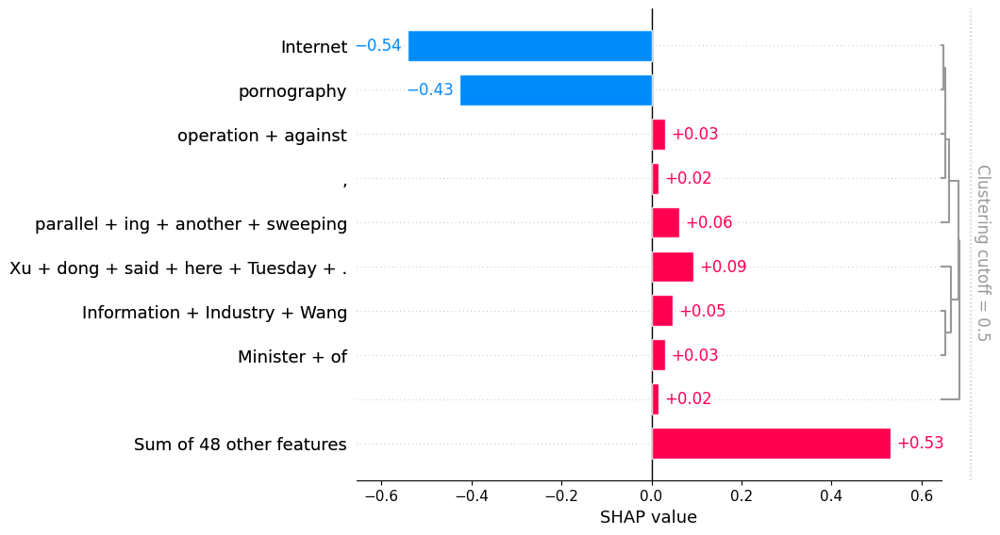

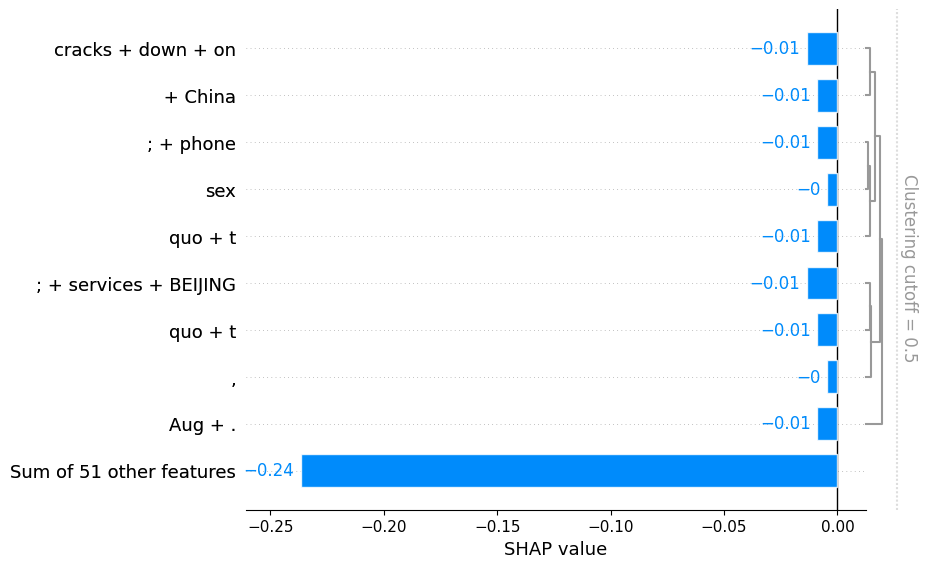

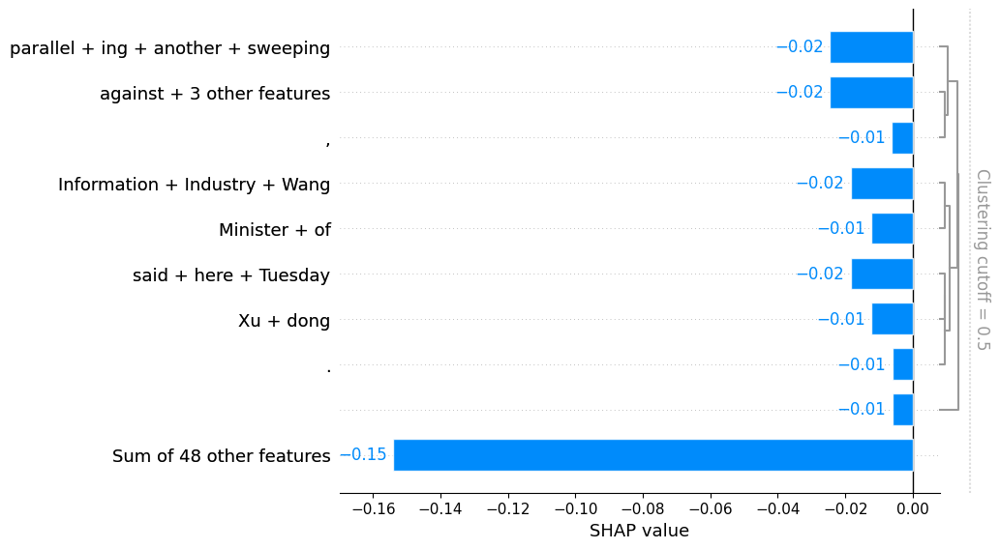

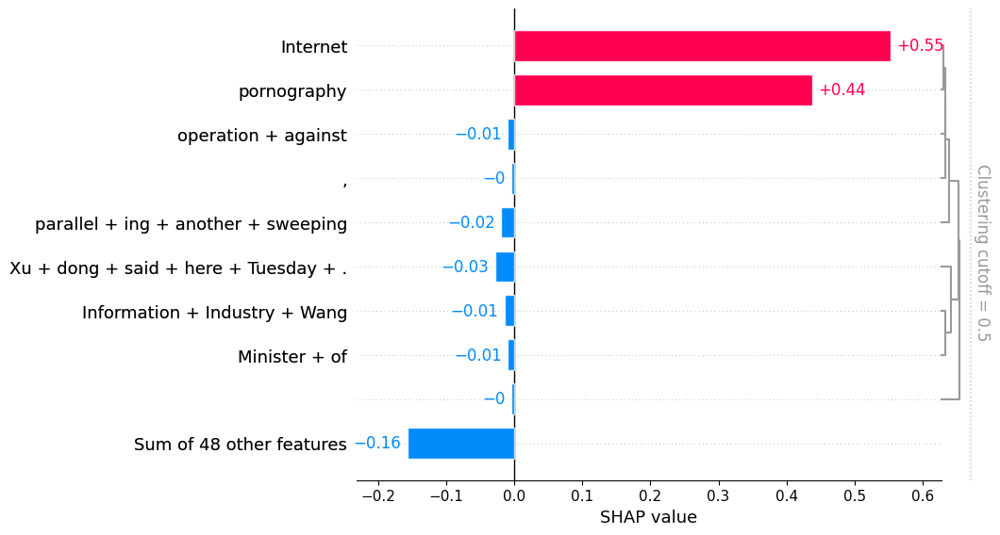

In [23]:
# Visualize the impact on a single class

shap_dict = {'World': shap.plots.bar(shap_values[0,:,'World']),
             'Sports': shap.plots.bar(shap_values[0,:,'Sports']),
             'Business': shap.plots.bar(shap_values[0,:,'Business']),
             'Sci/Tech': shap.plots.bar(shap_values[0,:,'Sci/Tech'])
            }